<a href="https://colab.research.google.com/github/2021-Energy-Climate-Hackathon/group_9/blob/main/pv_data_cleaning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import pandas as pd
import os

In [8]:
os.listdir(os.getcwd())

['.config', 'sample_data']

In [ ]:
df_london = pd.read_csv("/Users/nikolaushouben/Desktop/PV_Data/PV_Data_London/2014-11-28 Cleansed and Processed/EXPORT TenMinData/EXPORT TenMinData - Customer Endpoints.csv", index_col= "datetime", parse_dates=True)

In [ ]:
df_pv = df_london[["Substation", "P_GEN"]]

In [ ]:
df_pv.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 131681 entries, 2014-06-10 02:10:00 to 2014-11-19 18:20:00
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Substation  131681 non-null  object 
 1   P_GEN       131680 non-null  float64
dtypes: float64(1), object(1)
memory usage: 3.0+ MB


In [ ]:
gb = df_pv.groupby("Substation")

In [ ]:
groups = [gb.get_group(x) for x in gb.groups]

In [ ]:
for group in groups:
    group.columns = [group.columns[0], group.columns[1]+"_" + group.iloc[1:2,:1].values[0][0]]

In [ ]:
df = pd.DataFrame(index=group.index)

for group in groups:
    df = pd.merge(df, group.iloc[:,1:], left_index=True, right_index=True)



In [ ]:
df = df.apply(lambda x: x/x.max())

/Users/nikolaushouben/opt/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


2014-06-10    AxesSubplot(0.125,0.125;0.775x0.755)
2014-06-11    AxesSubplot(0.125,0.125;0.775x0.755)
2014-06-12    AxesSubplot(0.125,0.125;0.775x0.755)
2014-06-13    AxesSubplot(0.125,0.125;0.775x0.755)
2014-06-14    AxesSubplot(0.125,0.125;0.775x0.755)
                              ...                 
2014-09-29    AxesSubplot(0.125,0.125;0.775x0.755)
2014-09-30    AxesSubplot(0.125,0.125;0.775x0.755)
2014-10-01    AxesSubplot(0.125,0.125;0.775x0.755)
2014-10-02    AxesSubplot(0.125,0.125;0.775x0.755)
2014-10-03    AxesSubplot(0.125,0.125;0.775x0.755)
Length: 116, dtype: object

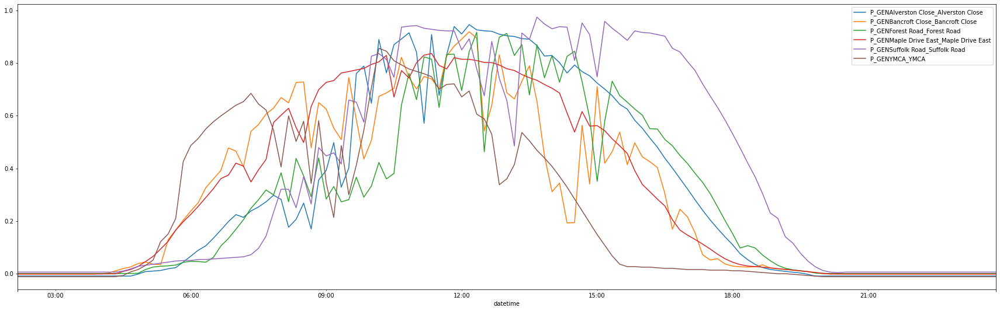

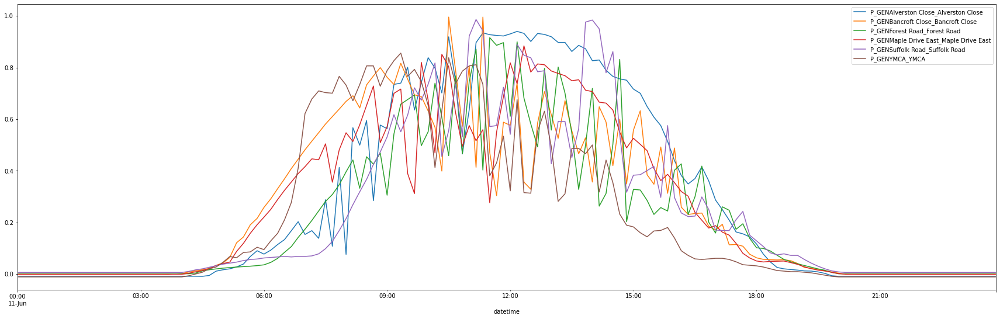

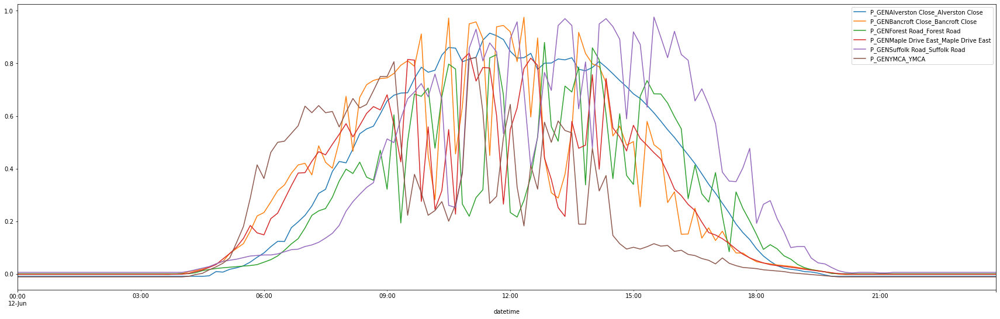

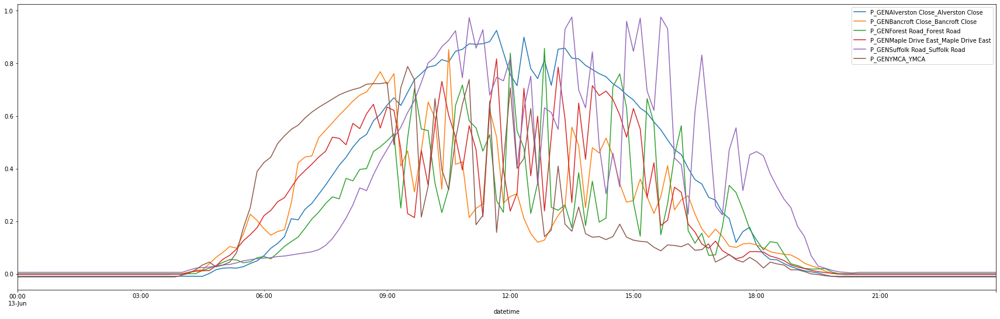

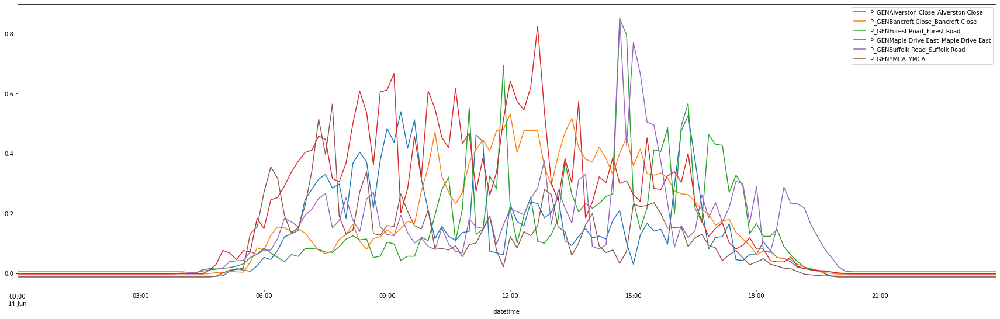

...

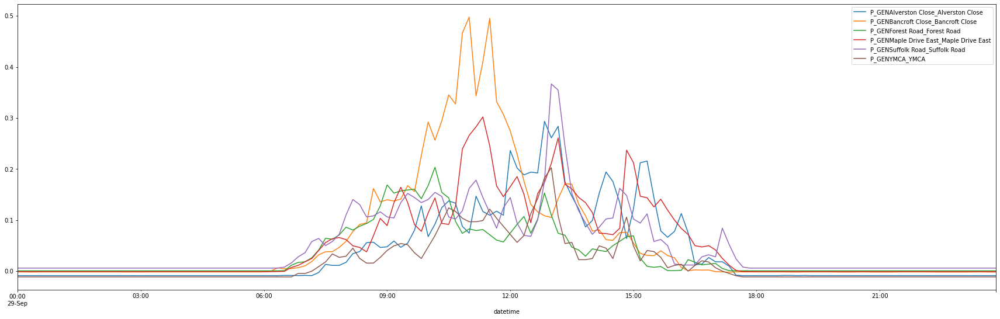

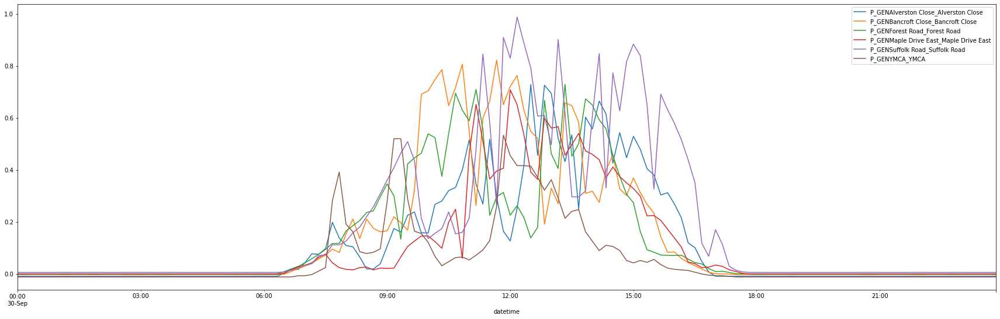

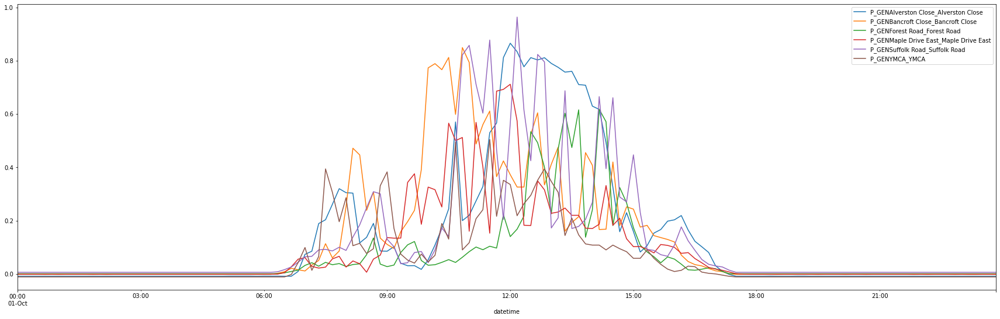

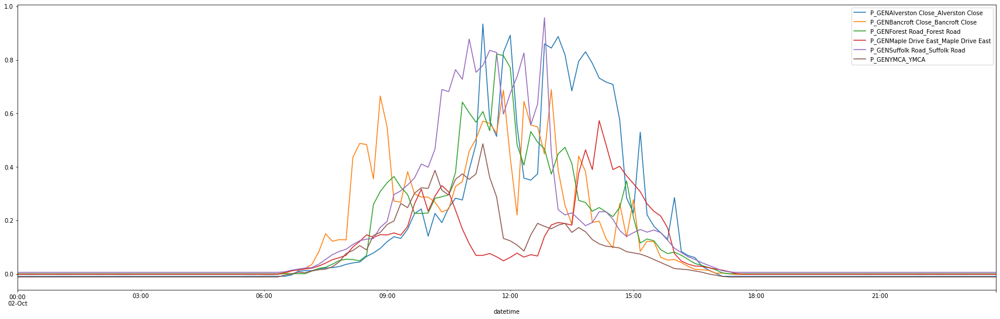

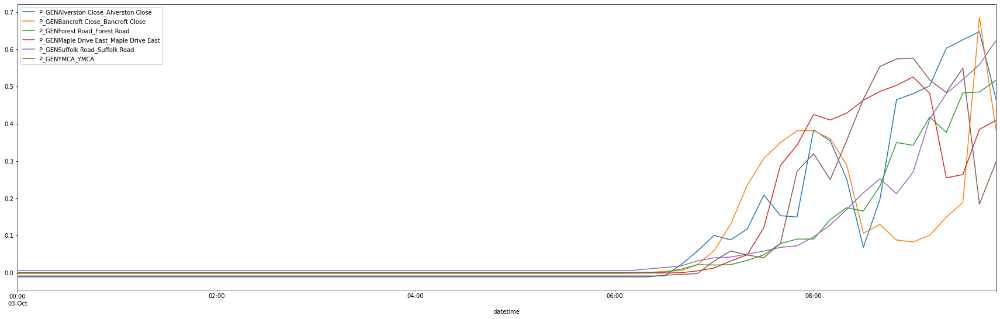

In [ ]:
df.groupby(df.index.date).plot(figsize= (30,9))